# Transcriptional Target Selection
> Curating lists of genes to target with Transcription Factors in Neurodegeneration

- toc: true
- comments: false
- hide: true


In [1]:
#collapse
# imports
import os, sys
import io
import json
import requests

def flatten(lol): return [x for l in lol for x in l]
def chunker(seq, size): return (seq[pos:pos + size] for pos in range(0, len(seq), size))

import pandas as pd
import numpy as np
import networkx as nx

import matplotlib.pyplot as plt
import seaborn as sns#; sns.set_theme()

plt.rcParams['figure.figsize'] = [12, 5]
plt.rcParams['figure.dpi'] = 140
plt.rcParams['agg.path.chunksize'] = 10000

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

from IPython.display import Image, HTML, IFrame, SVG, display

from Bio import SeqIO
from Bio.KEGG import REST, Gene
from Bio.KEGG.KGML import KGML_parser
from Bio.Graphics.KGML_vis import KGMLCanvas

from wand.image import Image as WImage
def wImage(fn, **kwargs): return WImage(filename=fn, **kwargs)

pd.set_option('display.max_rows', 200)

In [2]:
#collapse
# venn diagrams
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn3
import upsetplot

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

plt.rcParams['figure.figsize'] = [6, 3]
plt.rcParams['figure.dpi'] = 140
plt.rcParams['font.size'] = 8

import re
import traceback

def remove_special_characters(s): return re.sub('[^a-zA-Z0-9]', ' ', s)

def get_strings(stack):

    filename, lineno, function_name, code = stack[-2]
    names = [n.strip() for n in code[code.find("(")+1:code.rfind(")")].split(',')]

    common_prefix = os.path.commonprefix(names)
    common_suffix = os.path.commonprefix([name[::-1] for name in names])[::-1]
    if len(common_prefix) > 2:
        names = [name.removeprefix(common_prefix) for name in names]
    if len(common_suffix) > 2:
        names = [name.removesuffix(common_suffix) for name in names]
    if len(common_prefix) > 2 or len(common_suffix) > 2:
        names = [remove_special_characters(name) for name in names]

    return names

def form_list_of_tuples(names, iterables):

    final = []
    for name, iterable in zip(names, iterables):

        len_full = len(iterable)
        s = set(iterable)
        len_uniques = len(s)
        if len_uniques == len_full:
            name += f' ({len_uniques})'
        else:
            name += f' ({len_uniques} unique in {len_full})'

        final.append((s, name))

    return final

def venn(*args, **kwargs):

    if len(args) == 2: method = venn2
    elif len(args) == 3: method = venn3
    else: print('incorrect number of args')

    names = get_strings(traceback.extract_stack())
    final = form_list_of_tuples(names, args)

    return method(*zip(*final), **kwargs)


def upset(*args, **kwargs):

    names = get_strings(traceback.extract_stack())
    final = form_list_of_tuples(names, args)

    s = upsetplot.from_contents(dict(final))

    fig, upsetplot.UpSet(s, subset_size='count', show_counts=True).plot()

    return s, fig

In [3]:
#collapse
# clustering heatmaps
import scipy
import scipy.stats
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster import hierarchy

def sort_df_by_hclust_olo(df, how='both', method='ward', metric='euclidean'):
    '''
    how={'index', 'columns', 'both'}
    '''
    df = df.fillna(0)

    if how in ['index', 'both']:
        Z = linkage(df, method=method, metric=metric)
        order = hierarchy.leaves_list(hierarchy.optimal_leaf_ordering(Z, df))
        df = df.iloc[order]

    if how in ['columns', 'both']:
        df = df.T
        Z = linkage(df, method=method, metric=metric)
        order = hierarchy.leaves_list(hierarchy.optimal_leaf_ordering(Z, df))
        df = df.iloc[order].T

    return df.replace(0, np.nan)

In [4]:
#collapse
# scaling SVG
from IPython.display import SVG
from bs4 import BeautifulSoup
import re

def scale_svg(svg_object, scale=1.0):

    soup = BeautifulSoup(svg_object.data, 'lxml')
    svg_elt = soup.find("svg")
    w = svg_elt.attrs["width"].rstrip("pt")
    h = svg_elt.attrs["height"].rstrip("pt")

    ws = float(w)*scale
    hs = float(h)*scale

    svg_elt.attrs["width"] = f"{ws}pt"
    svg_elt.attrs["height"] = f"{hs}pt"
    svg_elt.attrs["viewbox"] = f"0.00 0.00 {ws} {hs}"

    g_elt = svg_elt.find("g")
    tf = g_elt.attrs["transform"]
    # non-greedy regex-search-and-replace
    tf2 = re.sub(
        "scale\(.*?\)",
        f"scale({scale} {scale})",
        tf
    )
    g_elt.attrs["transform"] = tf2

    svg_object.data = str(svg_elt)

    return svg_object

TODO in the future: 
- [check out wikipathways](https://www.wikipathways.org/index.php/Pathway:WP183)

<h4 class='no_toc'>KEGG functions</h4>

Helpful links: 

- [BioPython KEGG Tutorial](https://nbviewer.org/github/widdowquinn/notebooks/blob/master/Biopython_KGML_intro.ipynb)
- [Maybe possible to use matplotlib to draw KEGG pathways instead?](https://ctskennerton.github.io/2020/09/27/drawing-kegg-pathway-maps-using-biopython-and-matplotlib/)
- [KEGG ortholog table URL](https://www.kegg.jp/kegg-bin/view_ortholog_table?map=04142)

In [8]:
#collapse
# load reference genome and KEGG IDs
id_mapping = pd.read_csv('/Users/alex/Documents/scImputation/KEGG_hsa_ncbi_and_ENSG_ID_map.csv')

genome = pd.read_csv('/Users/alex/Documents/AChroMap/data/processed/GRCh38_V40.csv')
genome['gene_id'] = genome.gene_id.str.split('.').str[0]
gene_names = genome[['gene_id', 'gene_name']].drop_duplicates('gene_id').set_index('gene_id')

# ko_to_hsa = pd.read_csv('https://rest.kegg.jp/link/ko/hsa', sep='\t', header=None, names=['hsa', 'ko'])
# ko_to_hsa.to_csv('ko_to_hsa.csv', index=False)
# id_mapping = id_mapping.merge(ko_to_hsa, how='left', left_on='KEGG_id', right_on='hsa')

In [9]:
#collapse
# define functions to query KEGG database and process/visualize results
def to_df(result, **kwargs):
    return pd.read_table(io.StringIO(result), header=None, **kwargs)

def kegg_find(query):
    return to_df(REST.kegg_find('pathway', query).read(), names=['pathway_ID', 'pathway_name'])

def kegg2pdf(map_id, fn=None):
    # Get the background image first
    pathway = KGML_parser.read(REST.kegg_get(map_id, "kgml"))
    canvas = KGMLCanvas(pathway, import_imagemap=True)
    if isinstance(fn, type(None)):
        img_filename = "%s.pdf" % map_id
    else:
        img_filename = fn

    canvas.draw(img_filename)
    return img_filename

def get_KEGG_pathway_gene_members(pathway):

    pathway = KGML_parser.read(REST.kegg_get(pathway, 'kgml'))
    members = np.unique(flatten([gene.name.strip().split(' ') for gene in pathway.genes]))
    members = id_mapping[id_mapping.KEGG_id.isin(members)].drop_duplicates('KEGG_id').set_index('KEGG_id').reindex(members)
    members['gene_name'] = gene_names.reindex(members.ENSG).gene_name.values
    members = members[['ENSG', 'gene_name']].dropna()

    return members

def unpack_BRITE_json(d):
    if 'children' in d:
        return {d['name']: [unpack_BRITE_json(child) for child in d['children']]}
    else:
        if d['name'].startswith('K'):
            tmp = d['name'].split(';')
            tmp0 = tmp[0].split('  ')
            return [tmp0[0], [s.strip() for s in tmp0[1].split(',')], tmp[1].strip()]
        else:
            return d['name']

def second_parse(d, index=[]):
    if isinstance(d, dict):
        return flatten([second_parse(x, index+[k]) for k,v in d.items() for x in v])
    else:
        # print(d)
        return [[index, d[0], d[1]]]

all_gene_symbols_set = set(gene_names.gene_name.values)

def get_KEGG_BRITE_entry(brite_id):
    r = requests.get(f'https://rest.kegg.jp/get/br:{brite_id}/json')
    j = unpack_BRITE_json(r.json())
    j2 = pd.DataFrame(second_parse(j))
    j2 = j2.merge(id_mapping, how='left', left_on=1, right_on=id_mapping.ko.str.split(':').str[1])
    j2.index = pd.MultiIndex.from_tuples([tuple(x) for x in j2[0].values])
    brite_id = brite_id.split('+')[0]
    j2 = j2.loc[brite_id].drop(['ncbi_ID','KEGG_id','ko'], axis=1).rename(columns={1:'KEGG_ortholog_ID',2:'KEGG_gene_name'})

    j2['KEGG_gene_name'] = j2.KEGG_gene_name.apply(lambda l: [x for x in l if x in all_gene_symbols_set])
    j2['KEGG_gene_name'] = j2.KEGG_gene_name.apply(lambda l: l if len(l) else np.nan)

    j2['gene_name'] = gene_names.reindex(j2.ENSG).values

    j2 = j2.dropna(subset=['KEGG_gene_name','ENSG','gene_name'], how='all')

    def newcol(row):
        if (isinstance(row.KEGG_gene_name, list) and row.gene_name in row.KEGG_gene_name) or (str(row.KEGG_gene_name) == 'nan'):
            return np.nan
        else:
            return row.KEGG_gene_name[0]

    j2['newcol'] = j2.apply(newcol, axis=1)

    save_index = j2.index
    j2 = j2.merge(gene_names.reset_index(), how='left', left_on='newcol', right_on='gene_name')
    j2.index = save_index

    j2['gene_name_x'] = j2.gene_name_x.fillna(j2.gene_name_y)
    j2['ENSG'] = j2.ENSG.fillna(j2.gene_id)

    j2 = j2.drop(['KEGG_gene_name', 'newcol', 'gene_id', 'gene_name_y', 0, 'KEGG_ortholog_ID'], axis=1).rename(columns={'gene_name_x': 'gene_name'})

    return j2

def get_KEGG_data(pathway_code=None, brite_code=None):

    pathway_genes = None
    brite_genes = None

    if pathway_code:
        Image(REST.kegg_get(pathway_code, 'image').read())
        pathway_genes = get_KEGG_pathway_gene_members(pathway_code)

    if brite_code:
        brite_genes = get_KEGG_BRITE_entry(brite_code)

        if pathway_code:
            brite_genes['in_KEGG_pathway'] = brite_genes.ENSG.isin(pathway_genes.ENSG).astype(int)

    return pathway_genes, brite_genes


<h4 class='no_toc'>GO functions</h4>

In [11]:
#collapse
# define functions to query GO database and process/visualize results
def GO_subgraph_from_query(query):

    # nodes = pd.DataFrame({key: data for key, data in ontology_graph.nodes(data=True) if all(query in data['name'].lower() for query in queries)}, index=GO_columns).T
    nodes = pd.DataFrame({key: data for key, data in ontology_graph.nodes(data=True) if query.lower() in data['name'].lower()}, index=GO_columns).T
    nodes['gene_name'] = nodes.ENSG.apply(lambda l: gene_names.reindex(l).gene_name.values)
    g = ontology_graph_literate.subgraph(nodes.name.tolist())
    return g, nodes

def draw_graph(graph, scale=0.5):
    ag = nx.nx_agraph.to_agraph(graph)
    ag.graph_attr['rankdir']='LR'
    ag.node_attr['shape'] = 'record'
    svg = ag.draw(prog='dot',format='svg')
    # display(scale_svg(SVG(svg), scale))
    display(SVG(svg))

def create_GO_by_gene_matrix(node_df, attr='ENSG'):

    df = node_df.set_index('name')[attr].explode()
    df = (df.reset_index()
        .assign(v = True)
        .groupby(['name',attr]).first()
        .unstack(level=1)
        .fillna(False)
    )['v']

    if attr == 'ENSG': df = df.loc[:, df.columns.str.startswith('gene_name')]

    return df

sns.set(font_scale = 0.5)
cmap = sns.color_palette("light:b", as_cmap=True)

def plot_gene_membership_in_GO_terms(df, figsize=(10, 50)):

    ax = sns.clustermap(df.T, figsize=figsize, cbar=False, dendrogram_ratio=(0.001,0.001), colors_ratio=0.0001, cmap=cmap)
    ax.ax_row_dendrogram.set_visible(False)
    ax.ax_col_dendrogram.set_visible(False)
    ax.ax_cbar.set_visible(False)
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)

    return ax

ontology_graph = nx.read_gpickle('/Users/alex/Documents/goenrich-web/GO/human_GO.gpickle')
ontology_graph_literate = nx.relabel_nodes(ontology_graph, {key: data['name'] for key, data in ontology_graph.nodes(data=True)})
GO_columns = list(ontology_graph.nodes(data=True)['GO:0000001'].keys())

human_GO = pd.read_csv('/Users/alex/Documents/goenrich-web/GO/human_GO.csv')
human_GO['NCBI_ID'] = human_GO.NCBI_ID.str.split(';')
human_GO['ENSG'] = human_GO.ENSG.str.split(';')

def drop_nan_index_levels(df):
    for i in list(range(df.index.nlevels))[::-1]:
        if pd.isnull(df.index.get_level_values(i)).all():
            df.index = df.index.droplevel(i)
    return df


def KEGG_GO_venn(kegg_brite, GO_nodes):

    KEGG_list = np.unique(kegg_brite.ENSG.dropna().values)
    GO_list = np.unique(flatten(GO_nodes.ENSG.values))

    return venn(KEGG_list, GO_list)

In [12]:
# the GO function should get all sub-terms?

## Protein Aggregation


### Proteasome

<hr />


<h4 class='no_toc'>KEGG</h4>

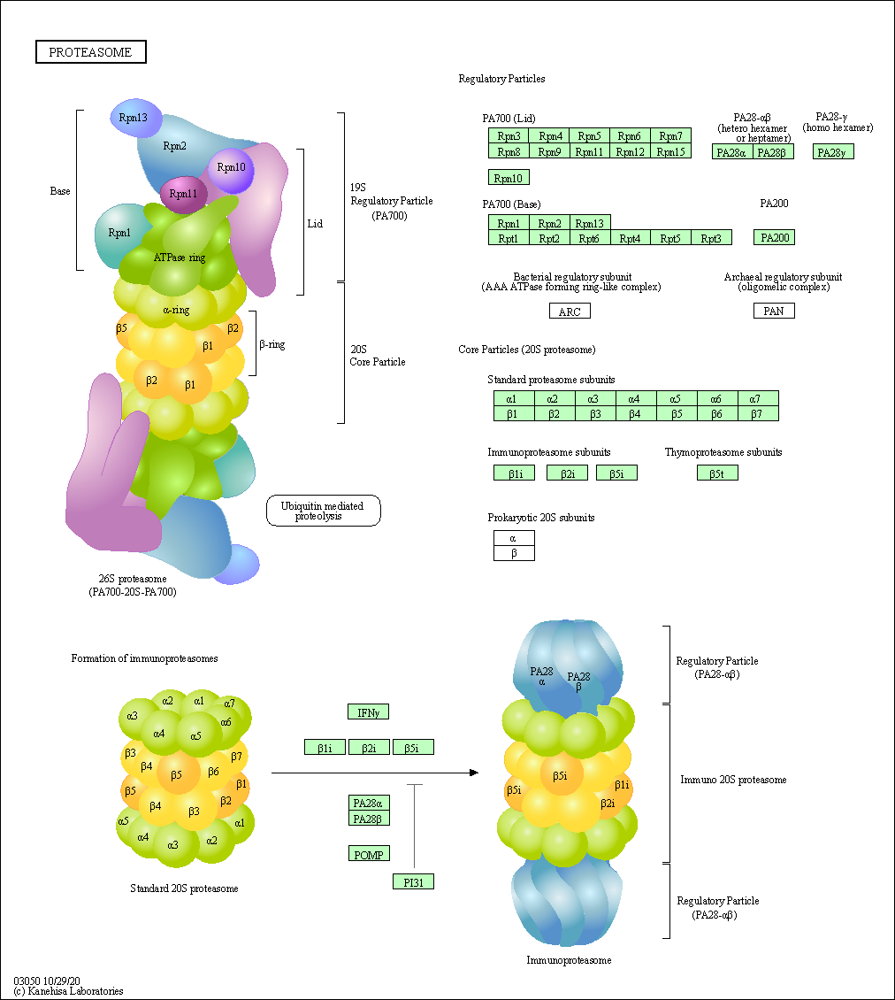

In [13]:
proteasome_pathway_id = 'hsa03050'
proteasome_brite_id = 'ko03051'
Image(REST.kegg_get(proteasome_pathway_id, 'image').read())

In [14]:
proteasome_pathway_genes = get_KEGG_pathway_gene_members(proteasome_pathway_id)

In [15]:
proteasome_brite_genes = get_KEGG_BRITE_entry(proteasome_brite_id)
proteasome_brite_genes = proteasome_brite_genes.loc['Eukaryotic proteasome']
proteasome_brite_genes['in_KEGG_pathway'] = proteasome_brite_genes.ENSG.isin(proteasome_pathway_genes.ENSG).astype(int)

In [16]:
proteasome_brite_genes.to_pickle('targets/proteasome_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [17]:
proteasome_subgraph, proteasome_nodes = GO_subgraph_from_query('proteasom')

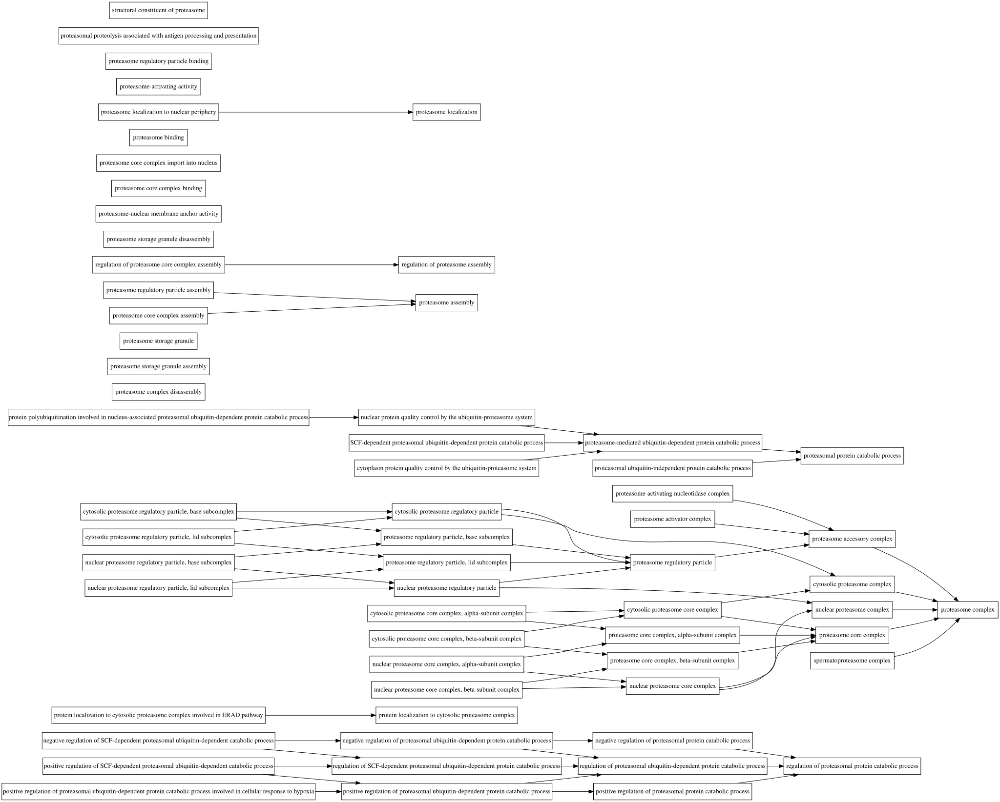

In [18]:
draw_graph(proteasome_subgraph)

In [19]:
df = create_GO_by_gene_matrix(proteasome_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [20]:
proteasome_nodes.to_pickle('targets/proteasome_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

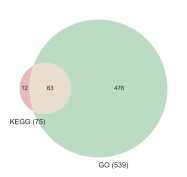

In [21]:
KEGG_GO_venn(proteasome_brite_genes, proteasome_nodes)

### Chaperones

<hr />


<h4 class='no_toc'>KEGG</h4>

In [22]:
chaperones_brite_id = 'ko03110'
chaperones_brite_genes = get_KEGG_BRITE_entry(chaperones_brite_id)

In [23]:
chaperones_brite_genes.to_pickle('targets/chaperone_brite.pickle')

<h4 class='no_toc'>GO</h4>

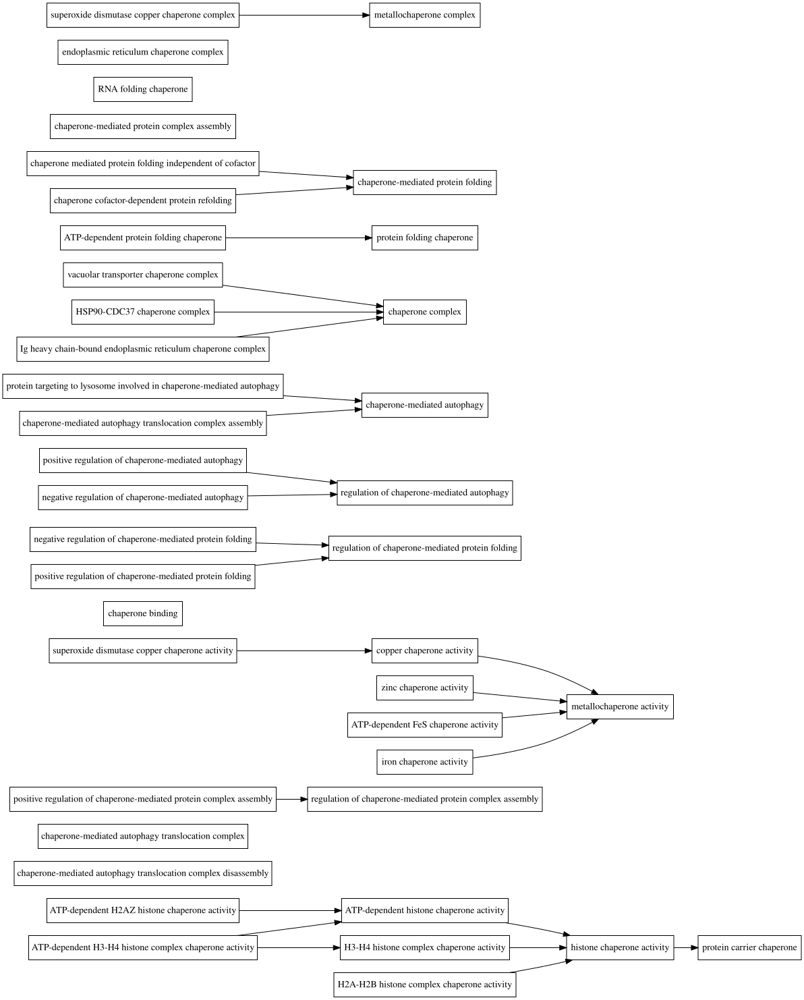

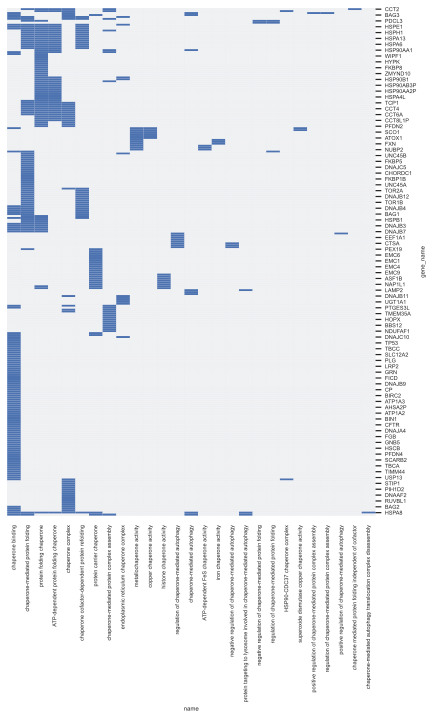

In [24]:
chaperone_subgraph, chaperone_nodes = GO_subgraph_from_query('chaperone')
draw_graph(chaperone_subgraph)
df = create_GO_by_gene_matrix(chaperone_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [25]:
chaperone_nodes.to_pickle('targets/chaperone_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

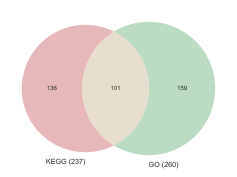

In [26]:
KEGG_GO_venn(chaperones_brite_genes, chaperone_nodes)

### Autophagy

<hr />

<h4 class='no_toc'>KEGG</h4>

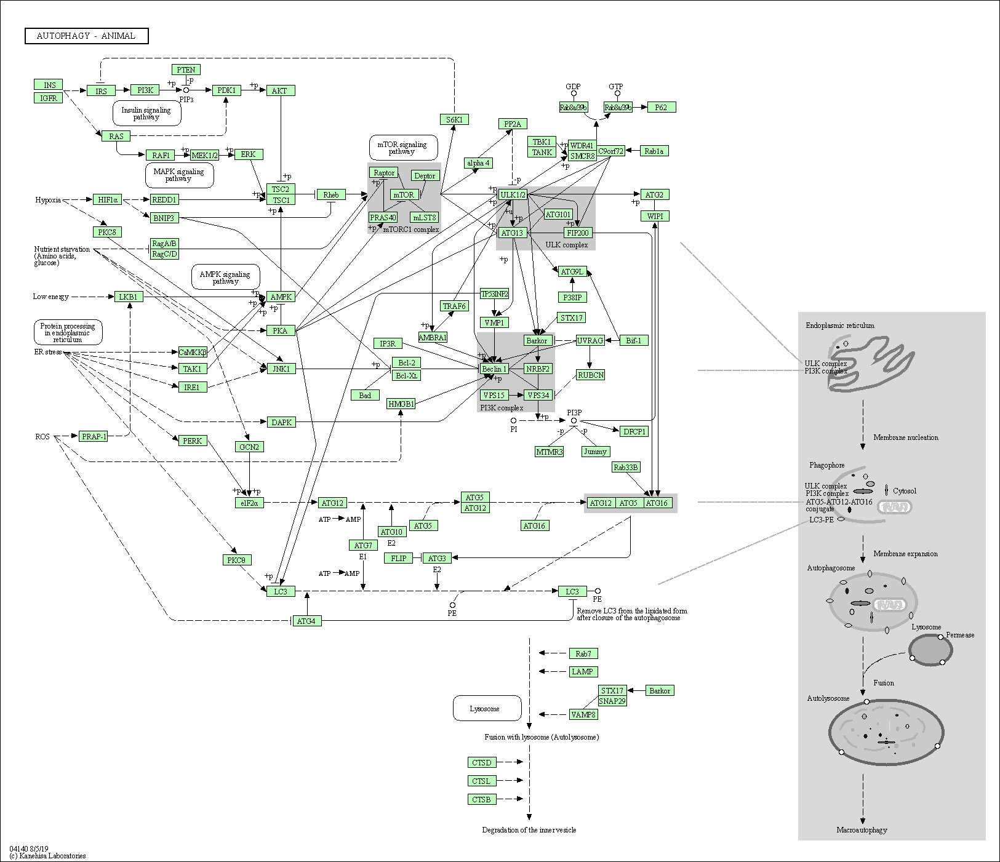

In [27]:
autophagy_KEGG_pathway = 'hsa04140'
autophagy_KEGG_BRITE = 'ko04131'
Image(REST.kegg_get(autophagy_KEGG_pathway, 'image').read())

In [28]:
autophagy_pathway_genes = get_KEGG_pathway_gene_members(autophagy_KEGG_pathway)

In [29]:
autophagy_brite_genes = get_KEGG_BRITE_entry(autophagy_KEGG_BRITE)

In [30]:
autophagy_brite_genes = autophagy_brite_genes.loc['Autophagy']

In [31]:
autophagy_brite_genes['in_KEGG_pathway'] = autophagy_brite_genes.ENSG.isin(autophagy_pathway_genes.ENSG).astype(int)

In [32]:
autophagy_brite_genes.to_pickle('targets/autophagy_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [33]:
autophagy_subgraph, autophagy_nodes = GO_subgraph_from_query('autophag')
df = create_GO_by_gene_matrix(autophagy_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
clustermap = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [34]:
autophagy_nodes.to_pickle('targets/autophagy_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

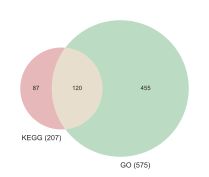

In [35]:
KEGG_GO_venn(autophagy_brite_genes, autophagy_nodes)

### Mitophagy

<hr />


<h4 class='no_toc'>KEGG</h4>

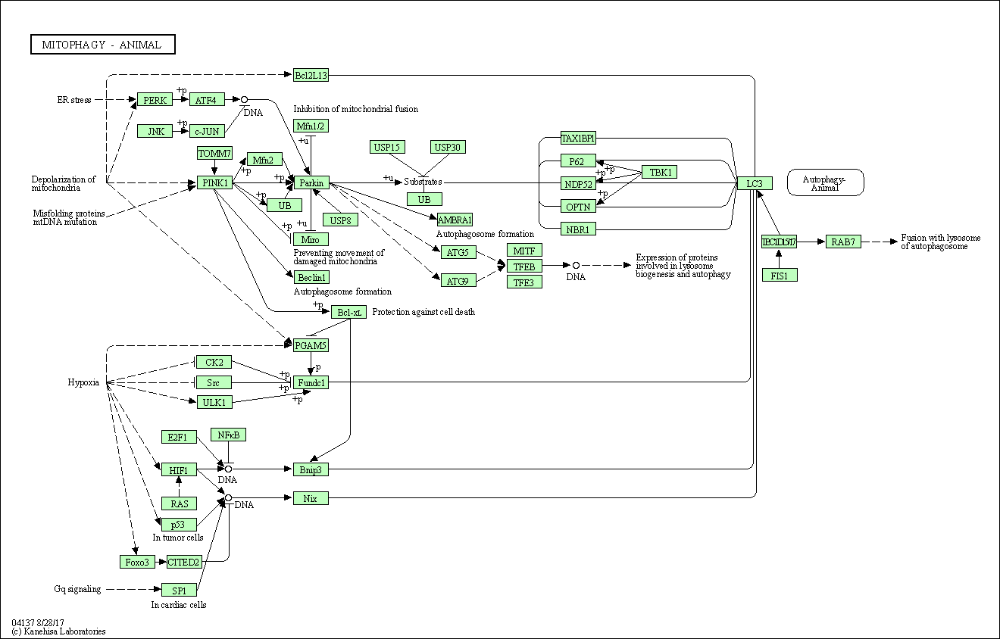

In [36]:
mitophagy_KEGG_pathway = 'hsa04137'
Image(REST.kegg_get(mitophagy_KEGG_pathway, 'image').read())

In [37]:
mitophagy_pathway_genes = get_KEGG_pathway_gene_members(mitophagy_KEGG_pathway)

In [38]:
mitophagy_brite_genes = pd.DataFrame(autophagy_brite_genes.loc['Mitophagy'])

In [39]:
mitophagy_brite_genes.drop(['in_KEGG_pathway'], axis=1, inplace=True)
mitophagy_brite_genes['in_KEGG_pathway'] = mitophagy_brite_genes.ENSG.isin(mitophagy_pathway_genes.ENSG).astype(int)
mitophagy_brite_genes.to_pickle('targets/mitophagy_brite.pickle')

<h4 class='no_toc'>GO</h4>

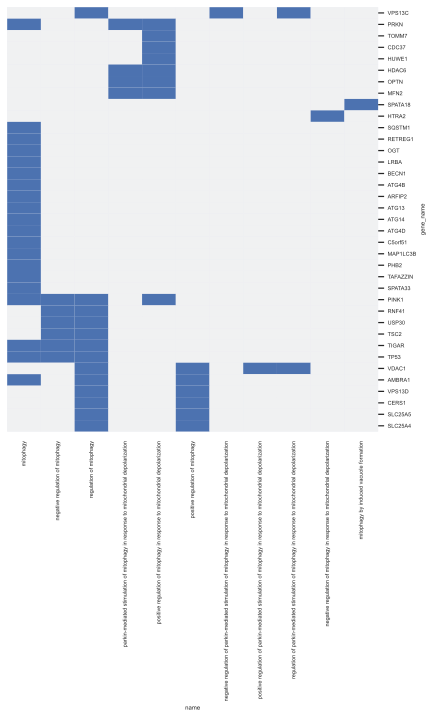

In [40]:
mitophagy_subgraph, mitophagy_nodes = GO_subgraph_from_query('mitophagy')
df = create_GO_by_gene_matrix(mitophagy_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [41]:
mitophagy_nodes.to_pickle('targets/mitophagy_GO.pickle')


<h4 class='no_toc'>Overlap</h4>

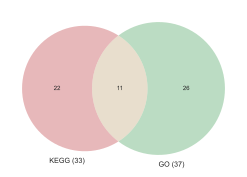

In [42]:
KEGG_GO_venn(mitophagy_brite_genes, mitophagy_nodes)

### Lysosomal acidification

<hr />

<h4 class='no_toc'>KEGG</h4>

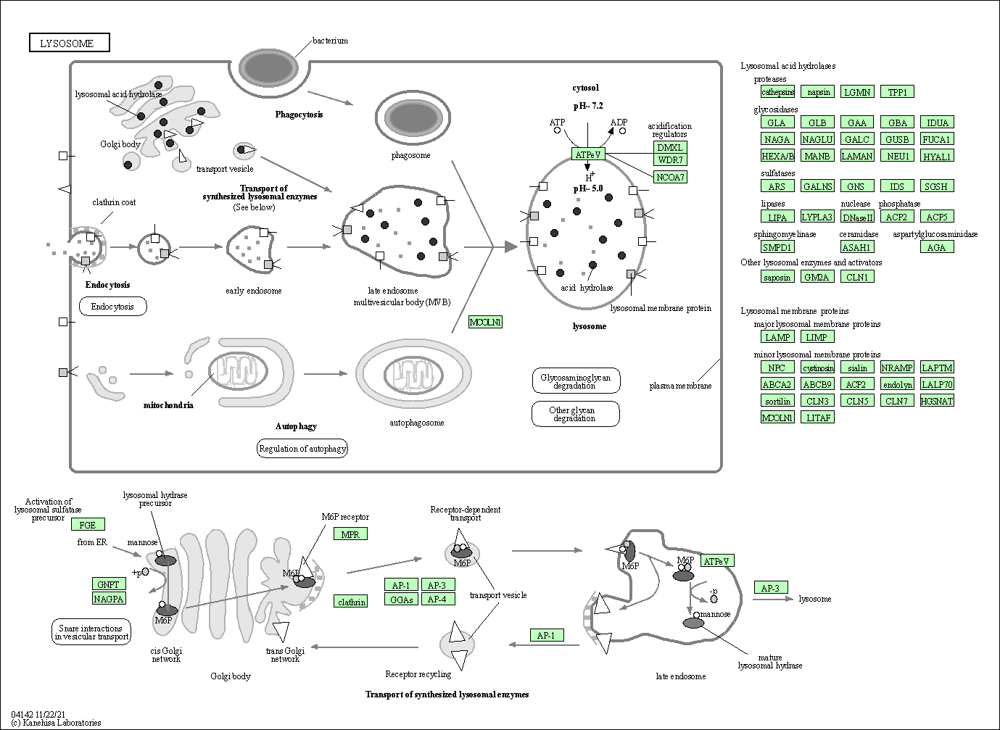

In [43]:
lysosome_KEGG_pathway = 'hsa04142'
Image(REST.kegg_get(lysosome_KEGG_pathway, 'image').read())

In [44]:
lysosome_pathway_genes = get_KEGG_pathway_gene_members(lysosome_KEGG_pathway)

In [45]:
lysosome_pathway_genes.set_index('ENSG')['gene_name'].to_pickle('./targets/lysosome_kegg.pickle')

<h4 class='no_toc'>GO</h4>

In [46]:
lysosome_subgraph, lysosome_nodes = GO_subgraph_from_query('lysosom')

In [47]:
df = create_GO_by_gene_matrix(lysosome_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [48]:
lysosome_nodes.to_pickle('targets/lysosome_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

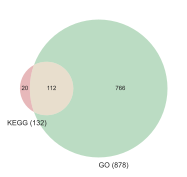

In [49]:
KEGG_GO_venn(lysosome_pathway_genes, lysosome_nodes)

## Heterochromatin Defects

In [50]:
brite = 'ko03036'
brite_genes = get_KEGG_BRITE_entry(brite)
brite_genes = brite_genes.loc['Eukaryotic type']

### TE de-repression

<hr />


In [51]:
# What is an ERV de-repression gene set?
# Silencing chromatin modifiers,
# TFs which recognize ERVs

[Restricting retrotransposons: a review](https://mobilednajournal.biomedcentral.com/articles/10.1186/s13100-016-0070-z)

![](https://media.springernature.com/full/springer-static/image/art%3A10.1186%2Fs13059-018-1577-z/MediaObjects/13059_2018_1577_Fig1_HTML.png?as=webp)

<h4 class='no_toc'>KEGG</h4>

In [52]:
gene_silencing_brite = brite_genes.loc['Gene silencing']
gene_silencing_brite.index = gene_silencing_brite.index.droplevel(2)

In [53]:
gene_silencing_brite.to_pickle('targets/gene_silencing_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [54]:
transposon_subgraph, transposon_nodes = GO_subgraph_from_query('transpos')

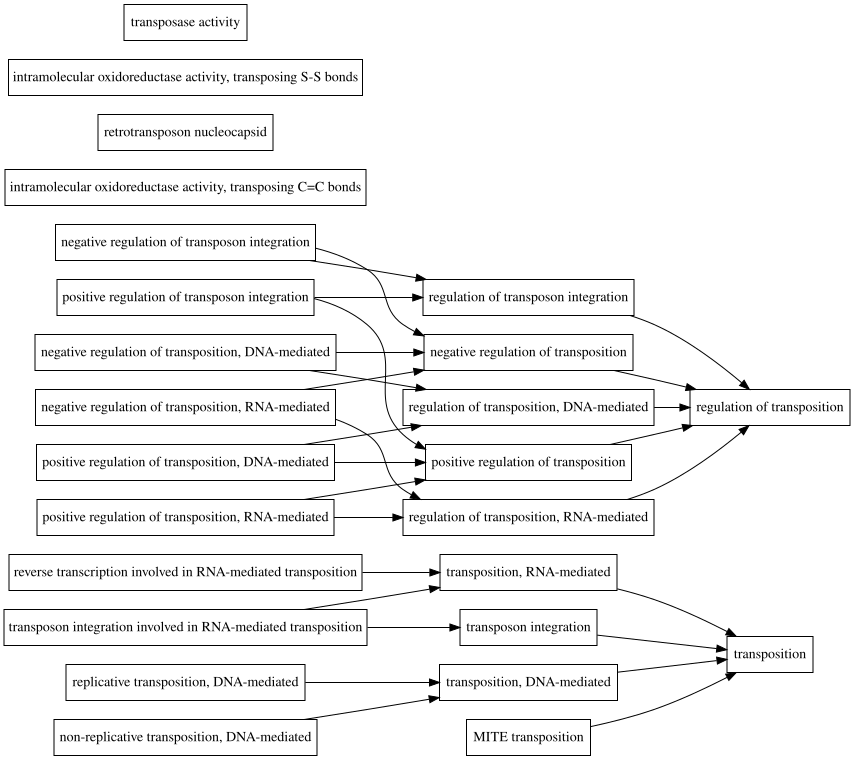

In [55]:
draw_graph(transposon_subgraph)

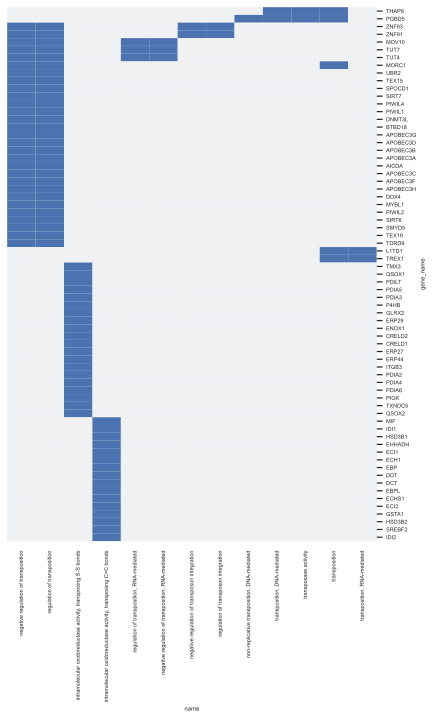

In [56]:
df = create_GO_by_gene_matrix(transposon_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

In [57]:
transposon_nodes.to_pickle('targets/transposon_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

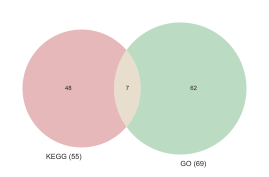

In [58]:
KEGG_GO_venn(gene_silencing_brite, transposon_nodes)

### Chromatin modifiers

<hr />


<h4 class='no_toc'>KEGG</h4>

In [59]:
chromatin_remodeling_brite = brite_genes.loc['Chromatin remodeling factors']
chromatin_remodeling_brite.index = chromatin_remodeling_brite.index.droplevel(2).droplevel(1)

In [60]:
chromatin_remodeling_brite.to_pickle('targets/chromatin_remodeling_brite.pickle')

In [61]:
histone_modification_brite = brite_genes.loc['Histone modification proteins']
histone_modification_brite = drop_nan_index_levels(histone_modification_brite)

In [62]:
histone_modification_brite.to_pickle('targets/histone_modification_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [63]:
chromatin_remodeling_subgraph, chromatin_remodeling_nodes = GO_subgraph_from_query('chromatin remodel')

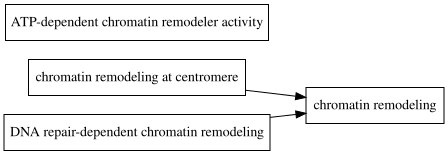

In [64]:
draw_graph(chromatin_remodeling_subgraph)

In [65]:
chromatin_remodeling_nodes.to_pickle('targets/chromatin_remodeling_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

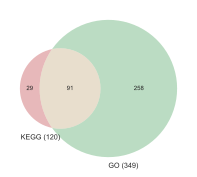

In [66]:
KEGG_GO_venn(chromatin_remodeling_brite, chromatin_remodeling_nodes)

### Epigenetic Erosion (heterochromatin loosening)

<hr />


<h4 class='no_toc'>KEGG</h4>

In [67]:
heterochromatin_formation_brite = brite_genes.loc['Heterochromatin formation proteins']
heterochromatin_formation_brite = drop_nan_index_levels(heterochromatin_formation_brite)

In [68]:
heterochromatin_formation_brite.to_pickle('targets/heterochromatin_formation_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [69]:
heterochromatin_subgraph, heterochromatin_nodes = GO_subgraph_from_query('heterochromatin')

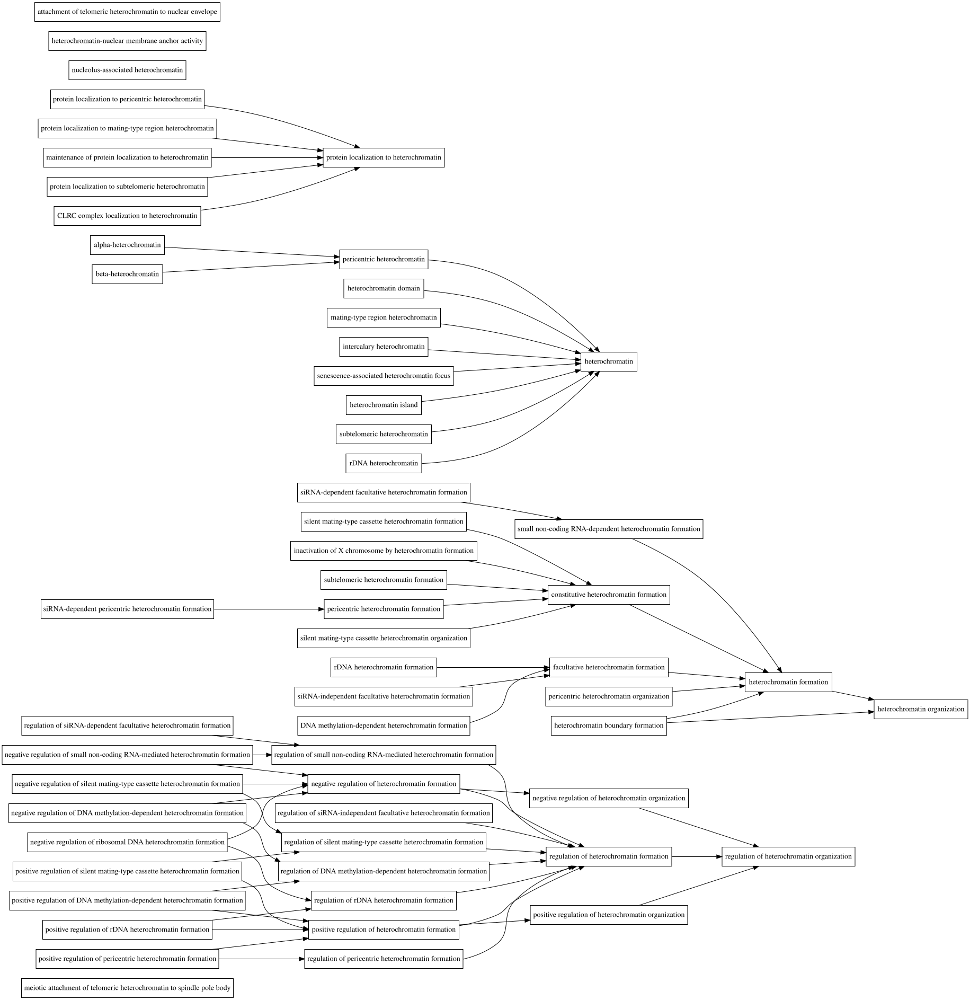

In [70]:
draw_graph(heterochromatin_subgraph)

In [71]:
heterochromatin_nodes.to_pickle('targets/heterochromatin_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

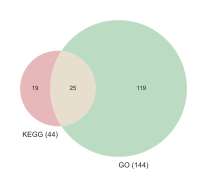

In [72]:
KEGG_GO_venn(heterochromatin_formation_brite, heterochromatin_nodes)


### histones are limiting

<hr />


<h4 class='no_toc'>KEGG</h4>

In [73]:
nucleosome_assembly_brite = brite_genes.loc['Nucleosome assembly factors']
nucleosome_assembly_brite = drop_nan_index_levels(nucleosome_assembly_brite)

In [74]:
nucleosome_assembly_brite.to_pickle('targets/nucleosome_assembly_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [75]:
nucleosome_assembly_subgraph, nucleosome_assembly_nodes = GO_subgraph_from_query('nucleosome assembly')

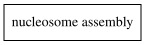

In [76]:
draw_graph(nucleosome_assembly_subgraph)

In [77]:
nucleosome_assembly_nodes.to_pickle('targets/nucleosome_assembly_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

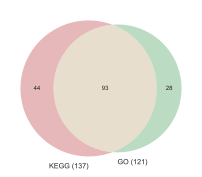

In [78]:
KEGG_GO_venn(nucleosome_assembly_brite, nucleosome_assembly_nodes)


### Nuclear Lamin defects

<hr />


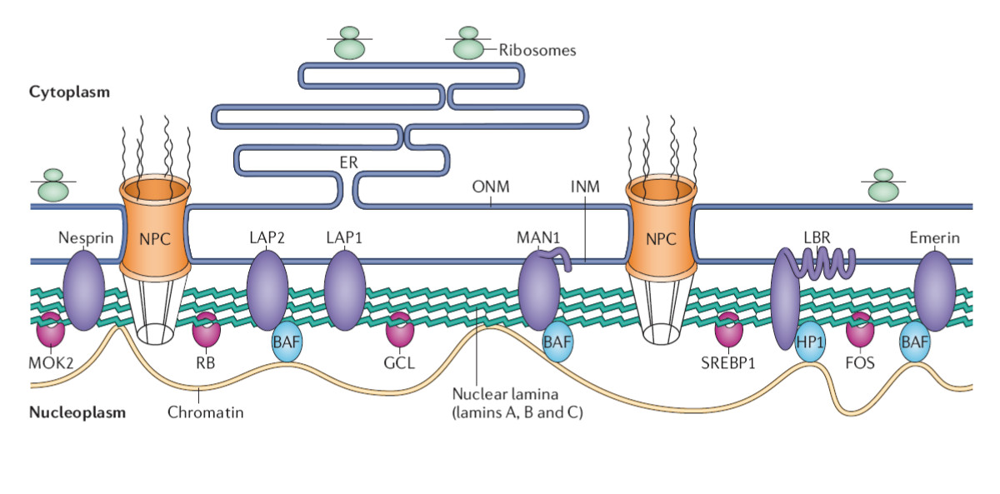

In [79]:
Image('https://upload.wikimedia.org/wikipedia/commons/b/b4/Structure_and_function_of_the_nuclear_lamina.jpg')

<h4 class='no_toc'>KEGG</h4>

In [80]:
nuclear_lamin_brite_id = 'ko04812+K12641'
nuclear_lamin_brite = get_KEGG_BRITE_entry(nuclear_lamin_brite_id)


In [81]:
nuclear_lamin_brite = nuclear_lamin_brite.loc['Eukaryotic cytoskeleton proteins', 'Intermediate filaments', 'Intermediate filaments', 'Type V: Nuclear lamins']
nuclear_lamin_brite.index = ['Nuclear lamins']*len(nuclear_lamin_brite)

/var/folders/mq/yzq45gh52xn7zz498z7cjtkw0000gn/T/ipykernel_10928/5367033.py:1: PerformanceWarning: indexing past lexsort depth may impact performance.
  nuclear_lamin_brite = nuclear_lamin_brite.loc['Eukaryotic cytoskeleton proteins', 'Intermediate filaments', 'Intermediate filaments', 'Type V: Nuclear lamins']


In [82]:
nuclear_lamin_brite.to_pickle('targets/nuclear_lamin_brite.pickle')

<h4 class='no_toc'>GO</h4>

In [83]:
nuclear_lamin_subgraph, nuclear_lamin_nodes = GO_subgraph_from_query('nuclear lamin')

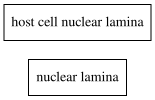

In [84]:
draw_graph(nuclear_lamin_subgraph)

In [85]:
nuclear_lamin_nodes.to_pickle('targets/nuclear_lamin_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

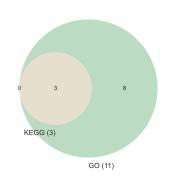

In [86]:
KEGG_GO_venn(nuclear_lamin_brite, nuclear_lamin_nodes)


### neurons entering cell cycle? Cell cycle markers

<hr />

<h4 class='no_toc'>KEGG</h4>

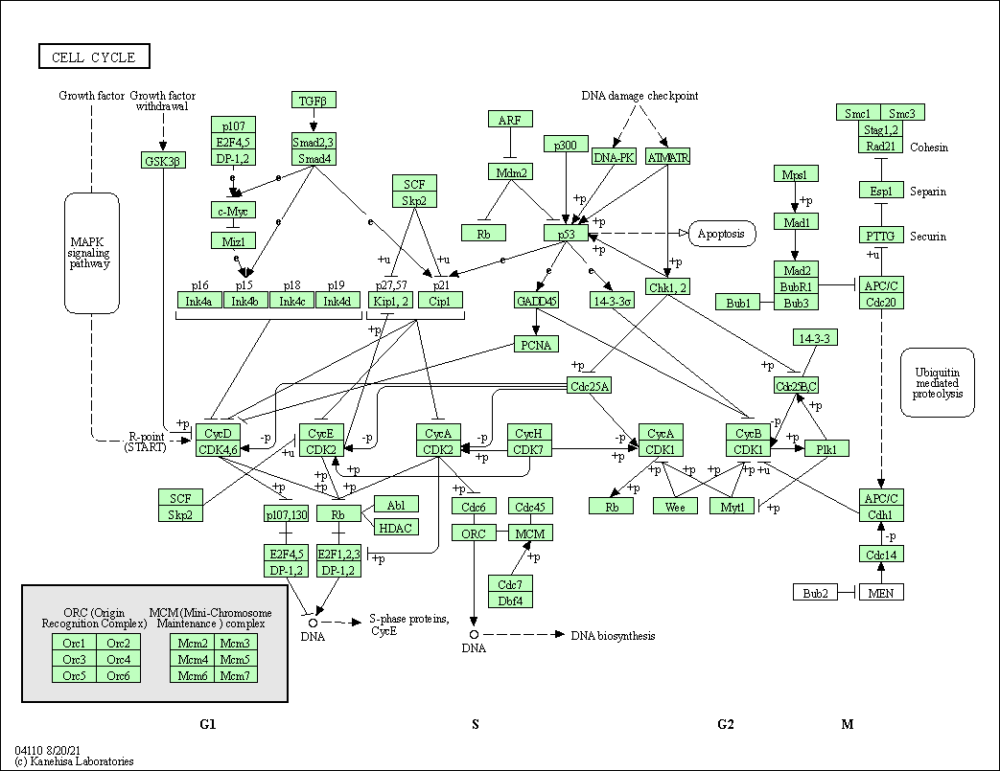

In [87]:
cell_cycle_pathway_id = 'hsa04110'
Image(REST.kegg_get(cell_cycle_pathway_id, 'image').read())

In [88]:
cell_cycle_pathway_genes = get_KEGG_pathway_gene_members(cell_cycle_pathway_id)

In [89]:
cell_cycle_pathway_genes.to_pickle('cell_cycle_pathway.pickle')

<h4 class='no_toc'>GO</h4>

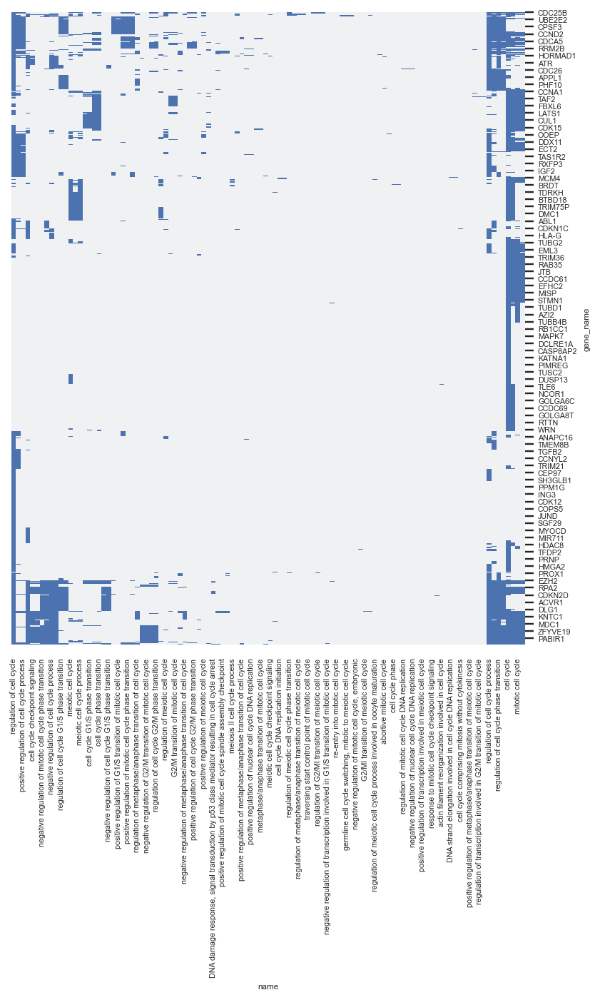

In [90]:
cell_cycle_subgraph, cell_cycle_nodes = GO_subgraph_from_query('cell cycle')
df = create_GO_by_gene_matrix(cell_cycle_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)

matplotlib_inline.backend_inline.set_matplotlib_formats('png')
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

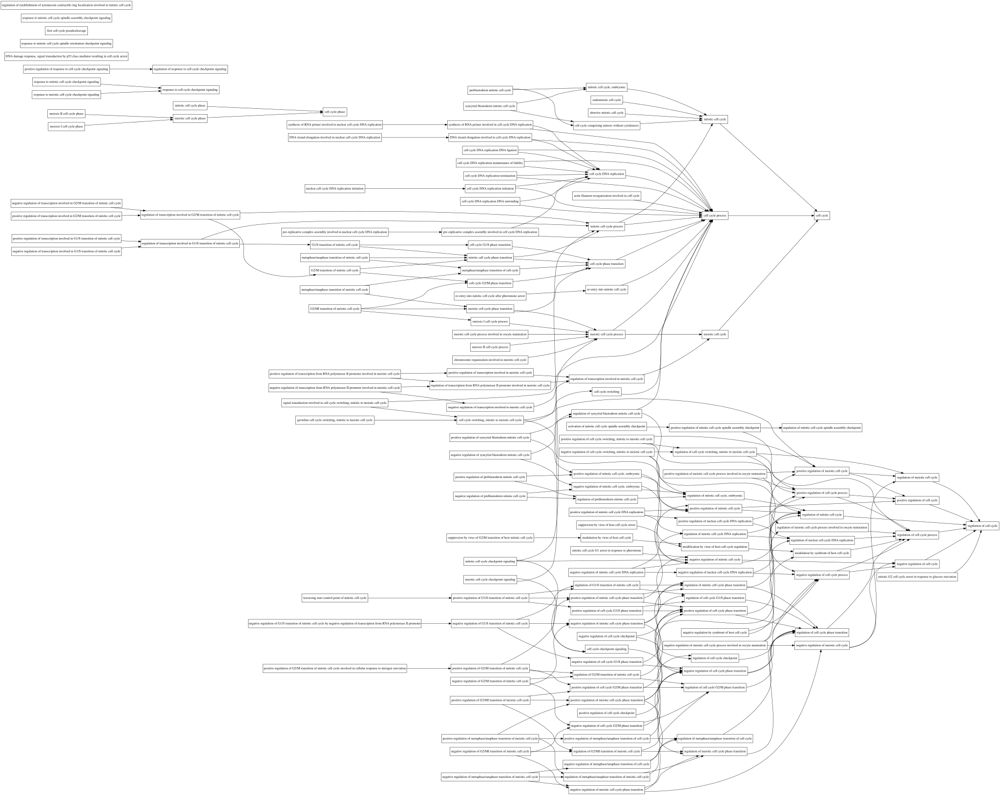

In [91]:
draw_graph(cell_cycle_subgraph)

In [92]:
cell_cycle_nodes.to_pickle('targets/cell_cycle_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

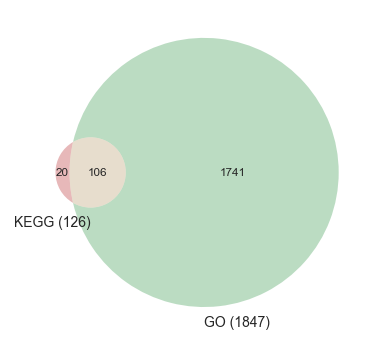

In [93]:
KEGG_GO_venn(cell_cycle_pathway_genes, cell_cycle_nodes)


## Inflammation

In [94]:
pd.set_option('display.max_rows', 200)
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')


### Inflammation Pathways

<hr />


<h4 class='no_toc'>KEGG</h4>

In [95]:
chemokine_pathway_id = 'hsa04062'
TNF_pathway_id = 'hsa04668'
complement_pathway_id = 'hsa04610'
leukocyte_transendothelial_migration_pathway_id = 'hsa04670'

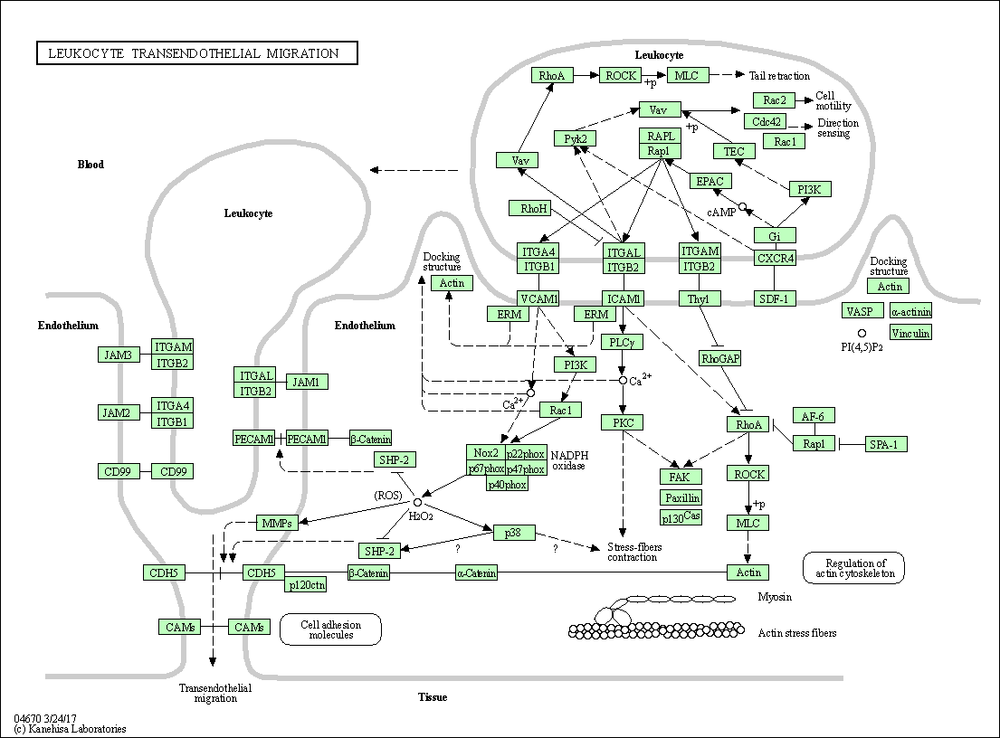

In [96]:
Image(REST.kegg_get(chemokine_pathway_id, 'image').read())
Image(REST.kegg_get(TNF_pathway_id, 'image').read())
Image(REST.kegg_get(complement_pathway_id, 'image').read())
Image(REST.kegg_get(leukocyte_transendothelial_migration_pathway_id, 'image').read())

In [97]:
chemokine_pathway_genes = get_KEGG_pathway_gene_members(chemokine_pathway_id)
TNF_pathway_genes = get_KEGG_pathway_gene_members(TNF_pathway_id)
complement_pathway_genes = get_KEGG_pathway_gene_members(complement_pathway_id)
leukocyte_transendothelial_migration_pathway_genes = get_KEGG_pathway_gene_members(leukocyte_transendothelial_migration_pathway_id)

In [98]:
chemokine_pathway_genes.index = ['Chemokine signaling pathway']*len(chemokine_pathway_genes)
TNF_pathway_genes.index = ['TNF signaling pathway']*len(TNF_pathway_genes)
complement_pathway_genes.index = ['Complement and coagulation cascades']*len(complement_pathway_genes)
leukocyte_transendothelial_migration_pathway_genes.index = ['Leukocyte transendothelial migration']*len(leukocyte_transendothelial_migration_pathway_genes)
inflammation_genes = pd.concat((chemokine_pathway_genes,TNF_pathway_genes,complement_pathway_genes,leukocyte_transendothelial_migration_pathway_genes))
inflammation_genes.to_pickle('targets/inflammation_brite.pickle')

<h4 class='no_toc'>GO</h4>

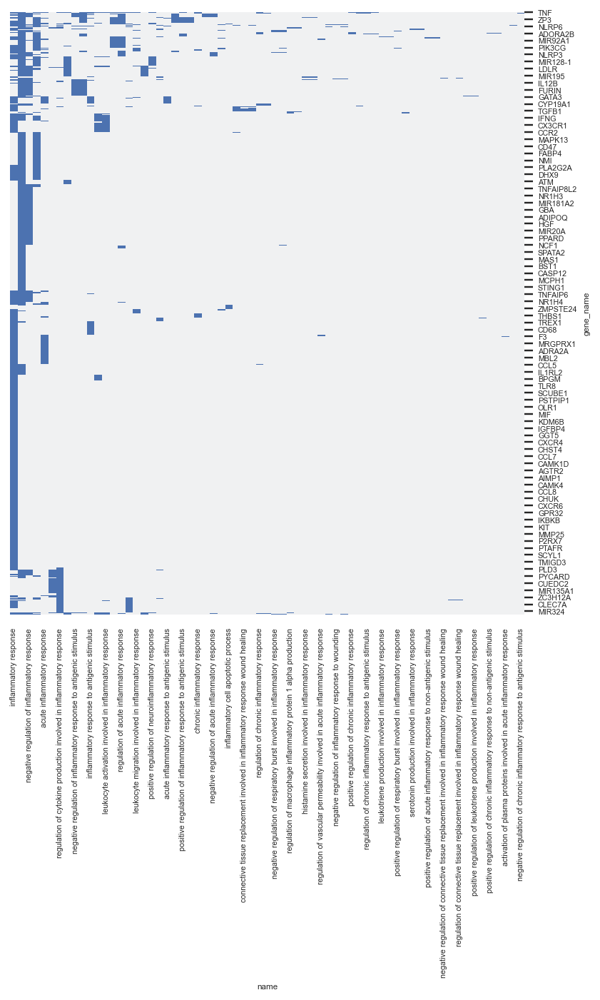

In [99]:
inflammation_subgraph, inflammation_nodes = GO_subgraph_from_query('inflammat')
df = create_GO_by_gene_matrix(inflammation_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)

matplotlib_inline.backend_inline.set_matplotlib_formats('png')
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

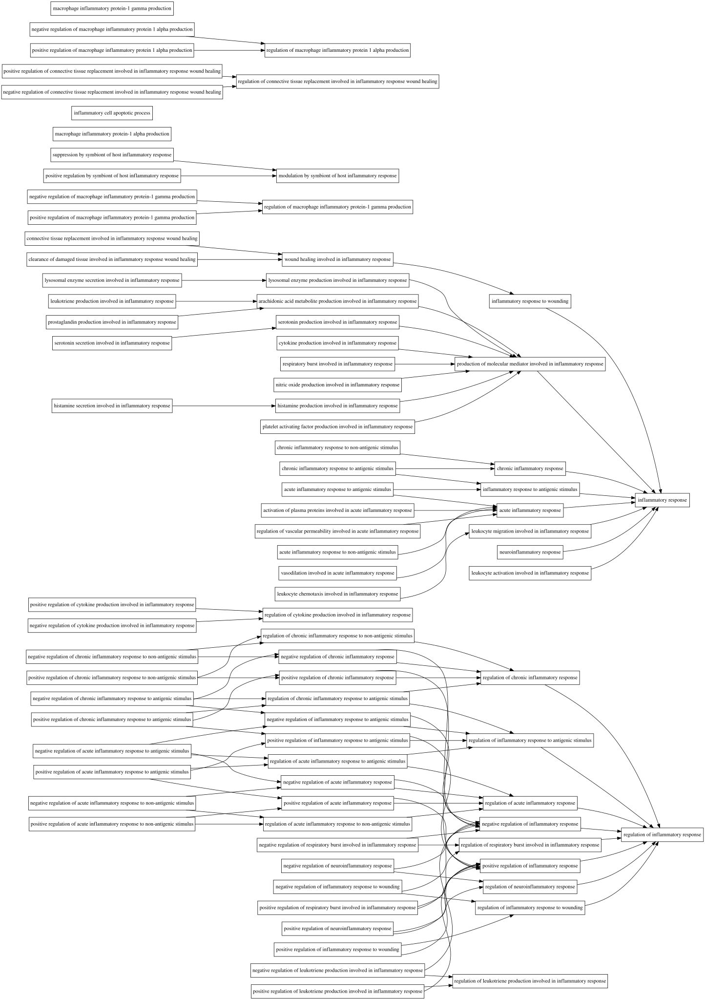

In [100]:
draw_graph(inflammation_subgraph)

In [101]:
inflammation_nodes.to_pickle('targets/inflammation_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

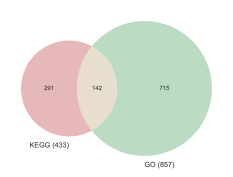

In [102]:
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
KEGG_GO_venn(inflammation_genes, inflammation_nodes)


### cytokines

<hr />


<h4 class='no_toc'>KEGG</h4>

In [103]:
cytokines_KEGG_BRITE = 'ko04052'
cytokines_brite_genes = get_KEGG_BRITE_entry(cytokines_KEGG_BRITE)

In [104]:
cytokines_brite_genes.to_pickle('targets/cytokines_brite.pickle')

<h4 class='no_toc'>GO</h4>

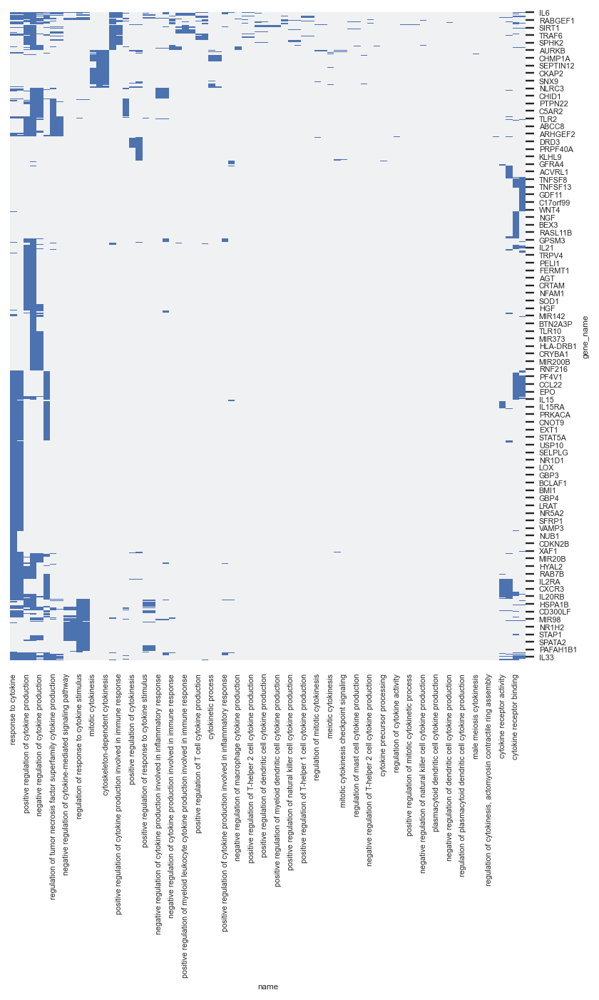

In [105]:
cytokines_subgraph, cytokines_nodes = GO_subgraph_from_query('cytokine')
df = create_GO_by_gene_matrix(cytokines_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)

matplotlib_inline.backend_inline.set_matplotlib_formats('png')
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

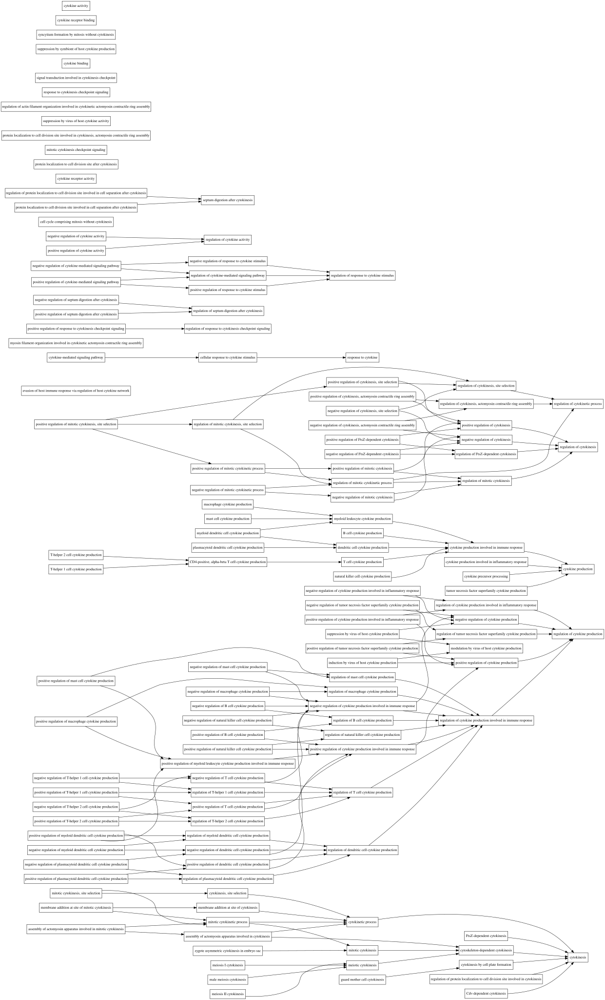

In [106]:
draw_graph(cytokines_subgraph)

In [107]:
cytokines_nodes.to_pickle('targets/cytokines_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

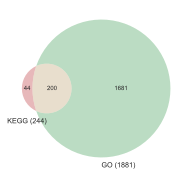

In [108]:
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
KEGG_GO_venn(cytokines_brite_genes, cytokines_nodes)


### cGAS-STING

<hr />

<h4 class='no_toc'>KEGG</h4>

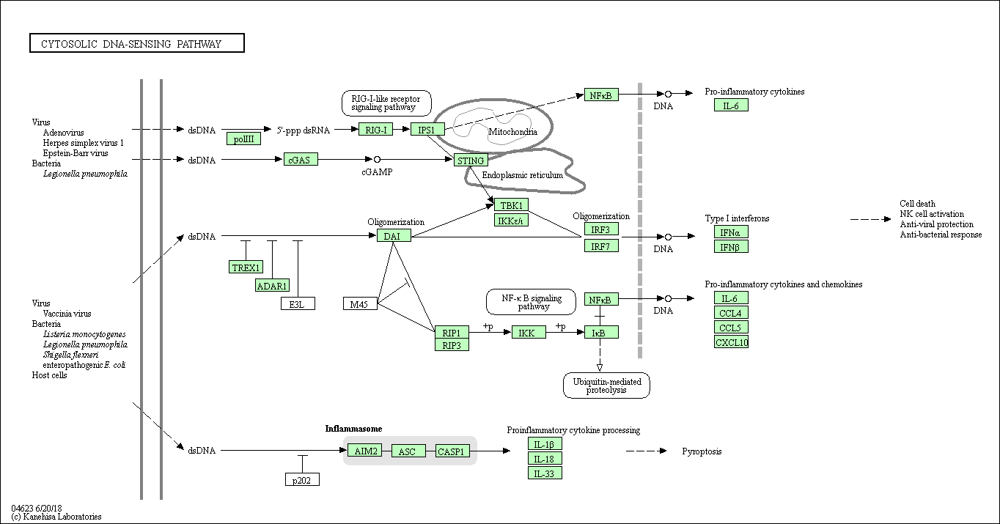

In [109]:
cGAS_STING_pathway_id = 'hsa04623'
Image(REST.kegg_get(cGAS_STING_pathway_id, 'image').read())

In [110]:
cGAS_STING_pathway_genes = get_KEGG_pathway_gene_members(cGAS_STING_pathway_id)

In [111]:
cGAS_STING_pathway_genes.to_pickle('targets/cGAS_STING_kegg.pickle')

<h4 class='no_toc'>GO</h4>

In [112]:
cGAS_STING_subgraph, cGAS_STING_nodes = GO_subgraph_from_query('activation of innate immune response')

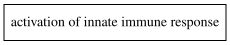

In [113]:
draw_graph(cGAS_STING_subgraph)

In [114]:
cGAS_STING_nodes.to_pickle('targets/cGAS_STING_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

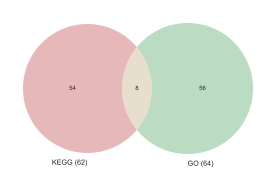

In [115]:
KEGG_GO_venn(cGAS_STING_pathway_genes, cGAS_STING_nodes)


### senescence programs

<hr />


<h4 class='no_toc'>KEGG</h4>

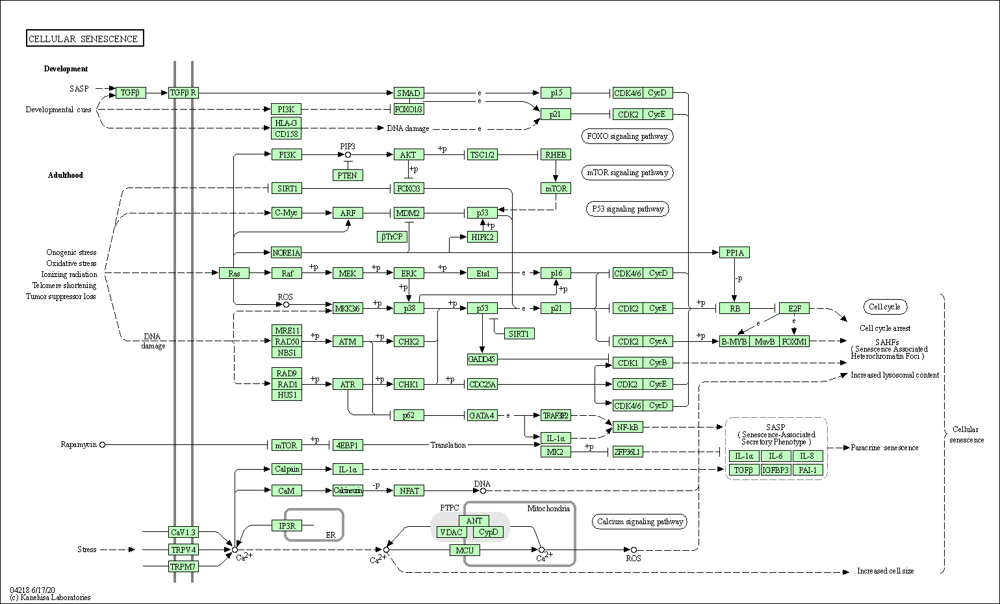

In [116]:
senescence_pathway = 'hsa04218'
Image(REST.kegg_get(senescence_pathway, 'image').read())

In [117]:
senescence_pathway_genes = get_KEGG_pathway_gene_members(senescence_pathway)

In [118]:
senescence_pathway_genes.to_pickle('targets/senescence_kegg.pickle')

<h4 class='no_toc'>GO</h4>

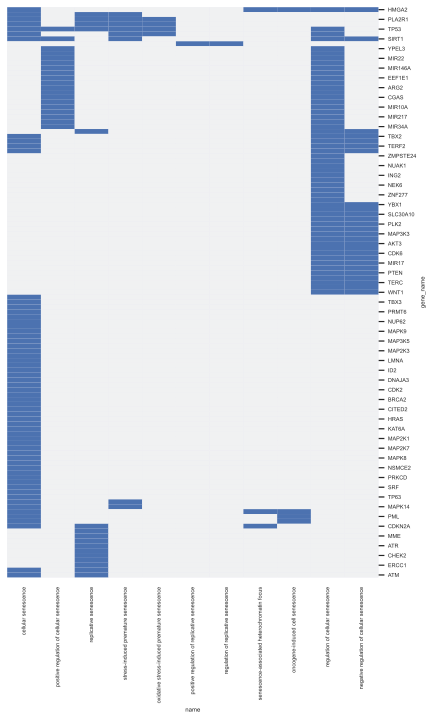

In [119]:
senescence_subgraph, senescence_nodes = GO_subgraph_from_query('senescence')
df = create_GO_by_gene_matrix(senescence_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)

matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

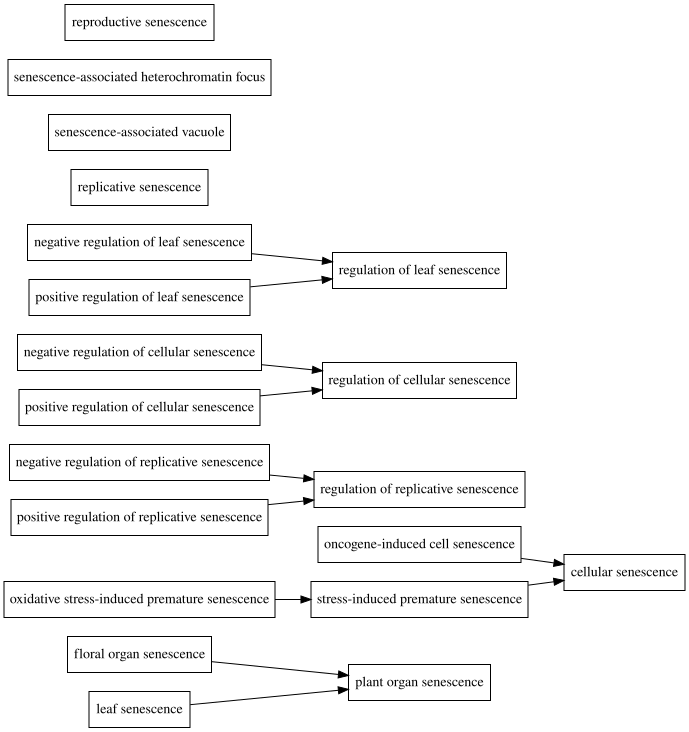

In [120]:
draw_graph(senescence_subgraph)

In [121]:
senescence_nodes.to_pickle('targets/senescence_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

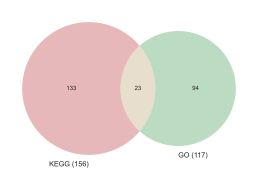

In [122]:
KEGG_GO_venn(senescence_pathway_genes, senescence_nodes)


### inflammasome activation

<hr />

<h4 class='no_toc'>KEGG</h4>

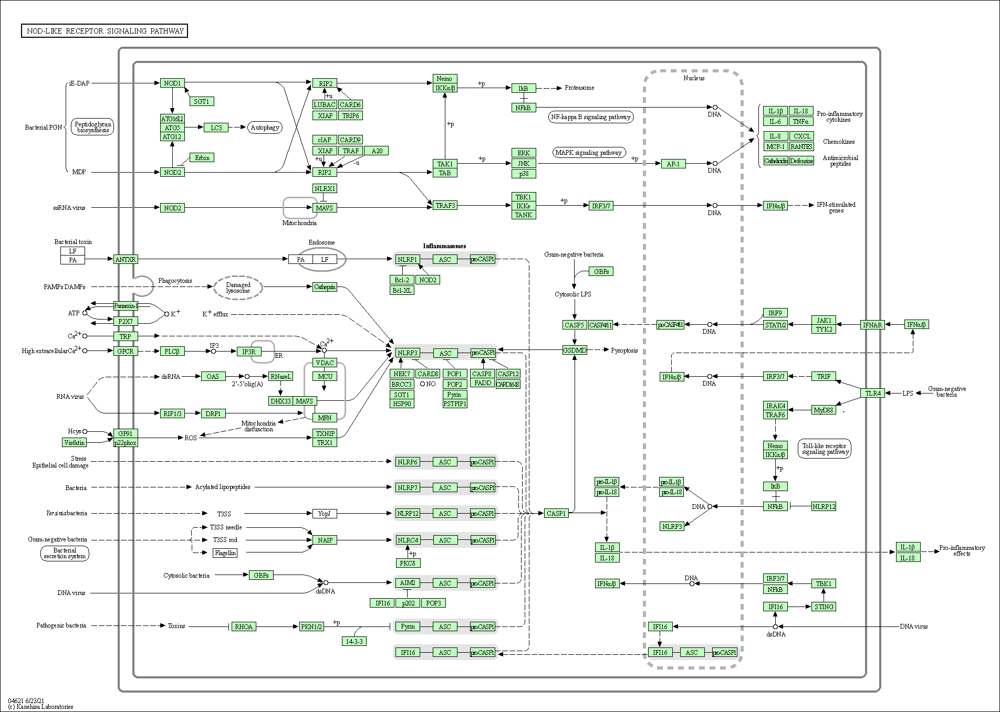

In [123]:
inflammasome_pathway = 'hsa04621'
Image(REST.kegg_get(inflammasome_pathway, 'image').read())

In [124]:
inflammasome_pathway_genes = get_KEGG_pathway_gene_members(inflammasome_pathway)

In [125]:
inflammasome_pathway_genes.to_pickle('targets/inflammasome_kegg.pickle')

<h4 class='no_toc'>GO</h4>

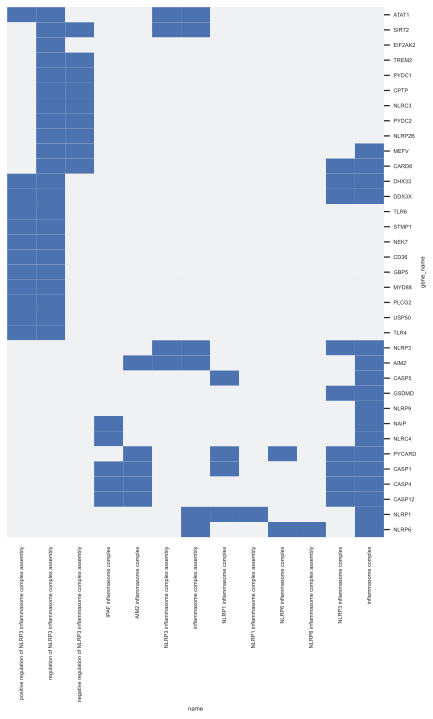

In [126]:
inflammasome_subgraph, inflammasome_nodes = GO_subgraph_from_query('inflammasome')
df = create_GO_by_gene_matrix(inflammasome_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)

# matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

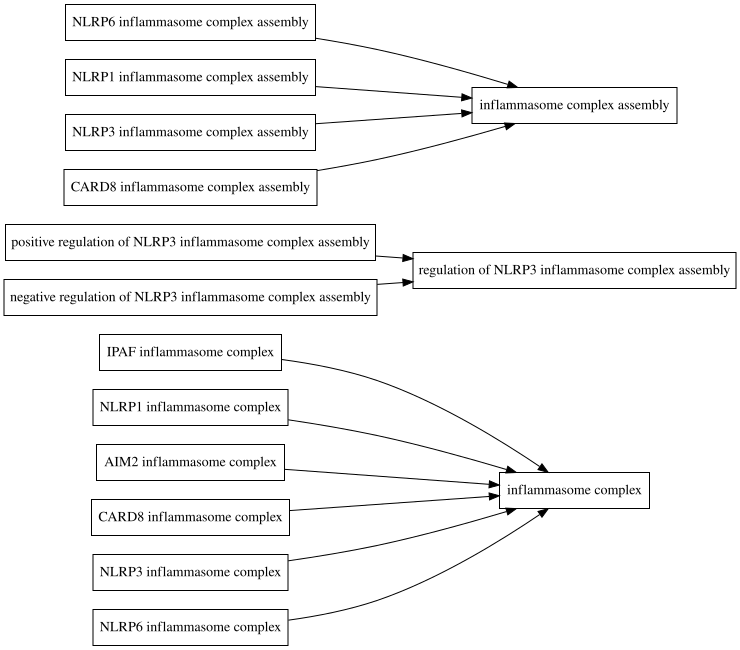

In [127]:
draw_graph(inflammasome_subgraph)

In [128]:
inflammasome_nodes.to_pickle('targets/inflammasome_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

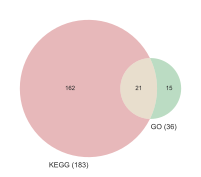

In [129]:
KEGG_GO_venn(inflammasome_pathway_genes, inflammasome_nodes)


## Metabolic Defects

### Glycolysis

<hr />

<h4 class='no_toc'>KEGG</h4>

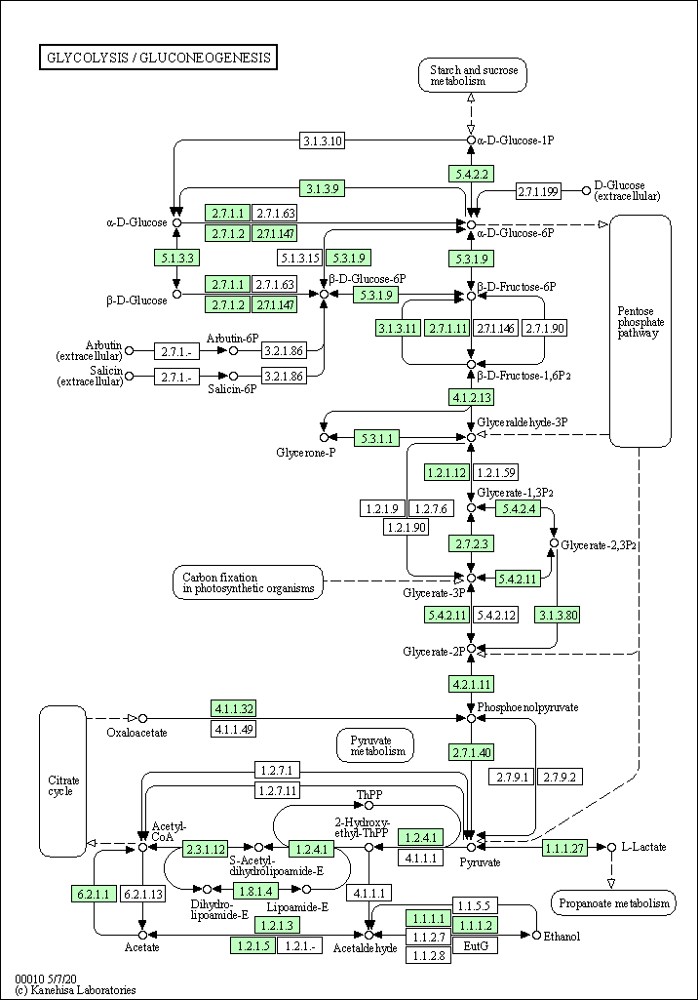

In [130]:
glycolysis_pathway_id = 'hsa00010'
# glycolysis_brite_id = 'ko03051'
Image(REST.kegg_get(glycolysis_pathway_id, 'image').read())

In [131]:
glycolysis_pathway_genes = get_KEGG_pathway_gene_members(glycolysis_pathway_id)

In [132]:
# proteasome_brite_genes = get_KEGG_BRITE_entry(proteasome_brite_id)
# proteasome_brite_genes = proteasome_brite_genes.loc['Eukaryotic proteasome']
# proteasome_brite_genes['in_KEGG_pathway'] = proteasome_brite_genes.ENSG.isin(proteasome_pathway_genes.ENSG).astype(int)

In [133]:
glycolysis_pathway_genes.to_pickle('targets/glycolysis_kegg.pickle')

<h4 class='no_toc'>GO</h4>

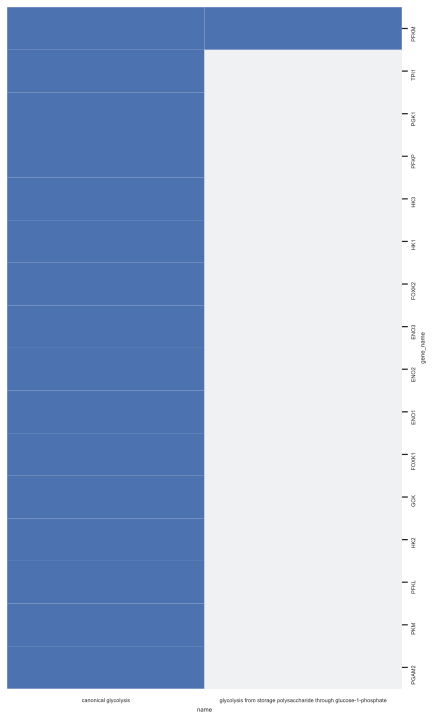

In [134]:
glycolysis_subgraph, glycolysis_nodes = GO_subgraph_from_query('glycolysis')
df = create_GO_by_gene_matrix(glycolysis_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

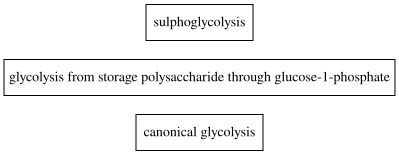

In [135]:
draw_graph(glycolysis_subgraph)

In [136]:
glycolysis_nodes.to_pickle('targets/glycolysis_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

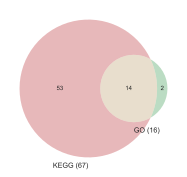

In [137]:
KEGG_GO_venn(glycolysis_pathway_genes, glycolysis_nodes)

### TCA Cycle

<hr />

<h4 class='no_toc'>KEGG</h4>

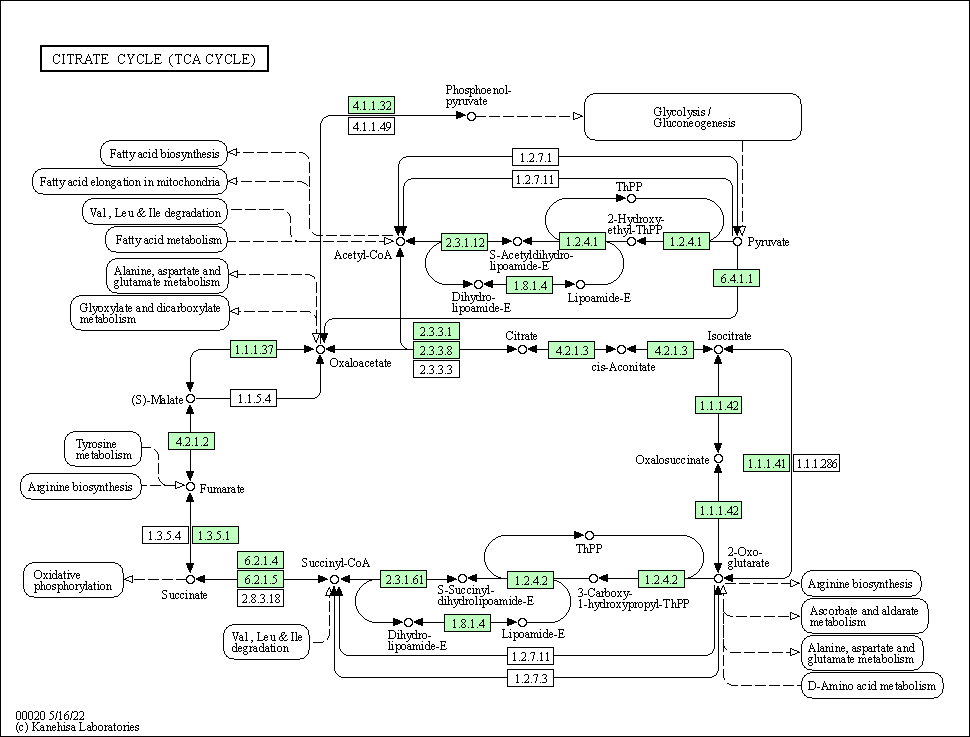

In [138]:
tca_pathway_id = 'hsa00020'
# tca_brite_id = 'ko03051'
Image(REST.kegg_get(tca_pathway_id, 'image').read())

In [139]:
tca_pathway_genes = get_KEGG_pathway_gene_members(tca_pathway_id)

In [140]:
# proteasome_brite_genes = get_KEGG_BRITE_entry(proteasome_brite_id)
# proteasome_brite_genes = proteasome_brite_genes.loc['Eukaryotic proteasome']
# proteasome_brite_genes['in_KEGG_pathway'] = proteasome_brite_genes.ENSG.isin(proteasome_pathway_genes.ENSG).astype(int)

In [141]:
tca_pathway_genes.to_pickle('targets/tca_kegg.pickle')

<h4 class='no_toc'>GO</h4>

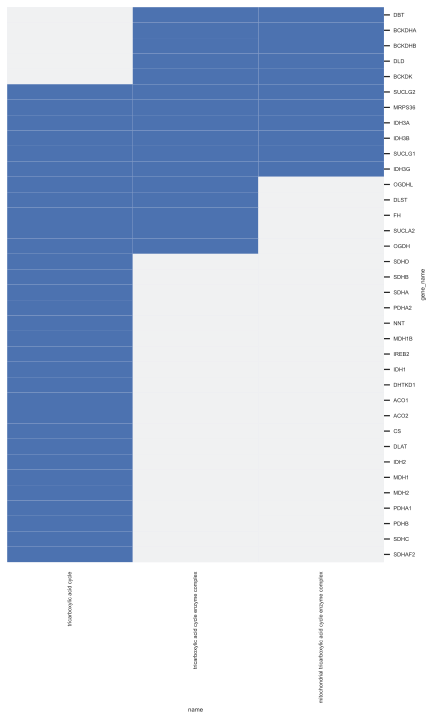

In [142]:
tca_subgraph, tca_nodes = GO_subgraph_from_query('tricarboxylic acid cycle')
df = create_GO_by_gene_matrix(tca_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

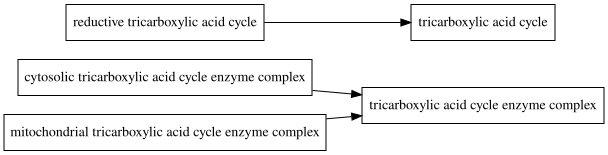

In [143]:
draw_graph(tca_subgraph)

In [144]:
tca_nodes.to_pickle('targets/tca_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

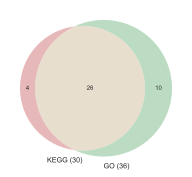

In [145]:
KEGG_GO_venn(tca_pathway_genes, tca_nodes)

### electron transport chain

<hr />

<h4 class='no_toc'>KEGG</h4>

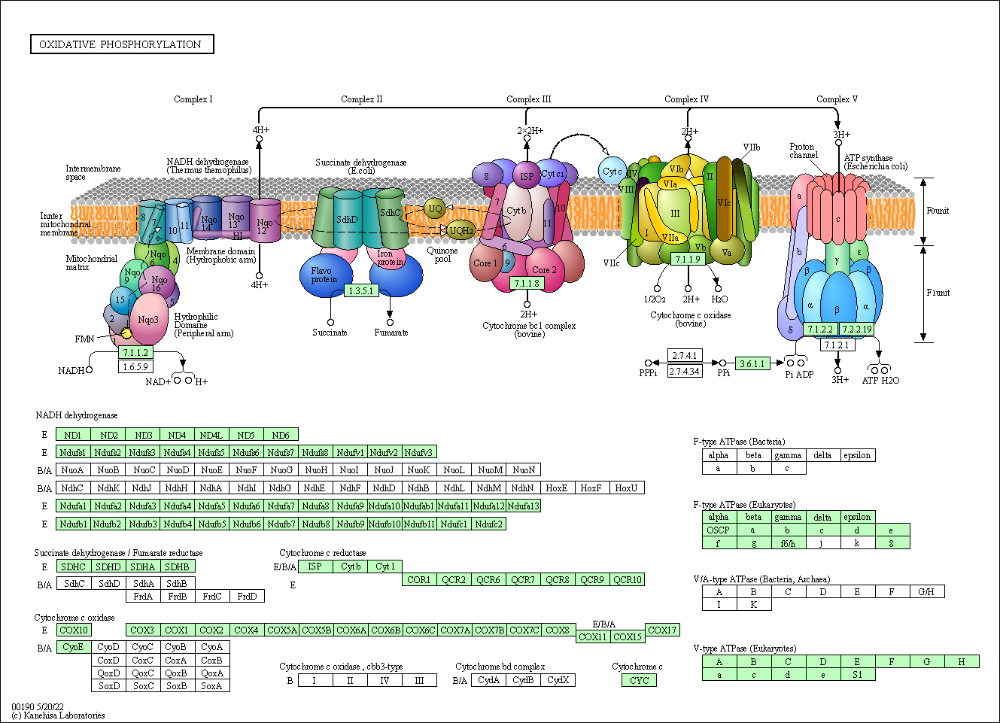

In [146]:
ETC_pathway = 'hsa00190'
Image(REST.kegg_get(ETC_pathway, 'image').read())

In [147]:
ETC_pathway_genes = get_KEGG_pathway_gene_members(ETC_pathway)

In [148]:
ETC_pathway_genes.to_pickle('targets/ETC_kegg.pickle')

<h4 class='no_toc'>GO</h4>

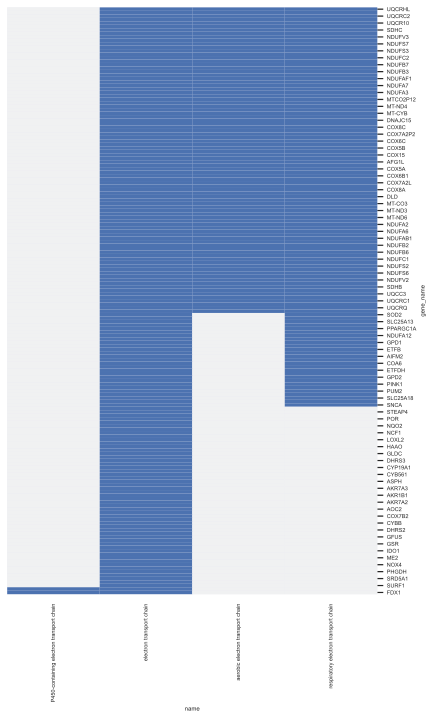

In [149]:
ETC_subgraph, ETC_nodes = GO_subgraph_from_query('electron transport chain')
df = create_GO_by_gene_matrix(ETC_nodes, attr='gene_name')
df = sort_df_by_hclust_olo(df)
ax = plot_gene_membership_in_GO_terms(df, figsize=(6, 10))

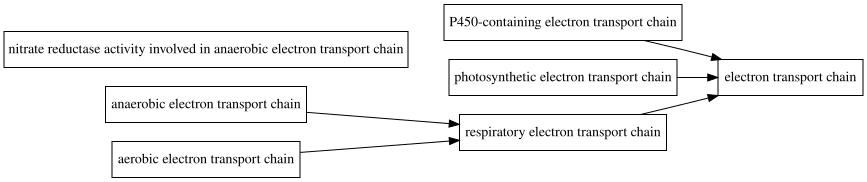

In [150]:
draw_graph(ETC_subgraph)

In [151]:
ETC_nodes.to_pickle('targets/ETC_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

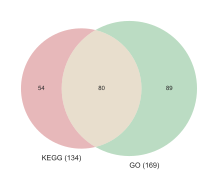

In [152]:
KEGG_GO_venn(ETC_pathway_genes, ETC_nodes)


### mitochondrial biogenesis

<hr />

<h4 class='no_toc'>KEGG</h4>

In [153]:
pd.set_option('display.max_rows', 200)

In [154]:
mitochondrial_biogenesis_brite_id = 'ko03029'
mitochondrial_biogenesis_brite_genes = get_KEGG_BRITE_entry(mitochondrial_biogenesis_brite_id)

In [155]:
mitochondrial_biogenesis_brite_genes = mitochondrial_biogenesis_brite_genes.loc[['Mitochondrial DNA transcription, translation, and replication factors','Mitochondrial quality control factors']]
# mitochondrial_biogenesis_brite.loc['Mitochondrial DNA transcription, translation, and replication factors']


In [156]:
mitochondrial_biogenesis_brite_genes.to_pickle('targets/mitochondrial_biogenesis_brite.pickle')

<h4 class='no_toc'>GO</h4>

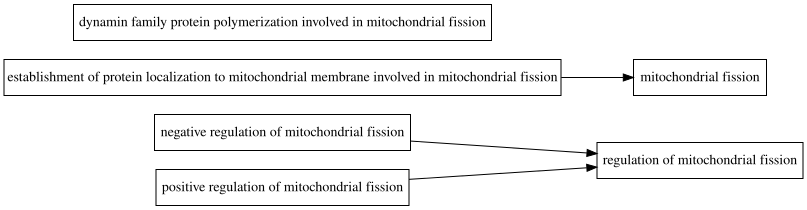

In [157]:
mitochondrial_biogenesis_subgraph, mitochondrial_biogenesis_nodes = GO_subgraph_from_query('mitochondrial fission')
draw_graph(mitochondrial_biogenesis_subgraph)

In [158]:
mitochondrial_biogenesis_nodes.to_pickle('targets/mitochondrial_biogenesis_GO.pickle')

<h4 class='no_toc'>Overlap</h4>

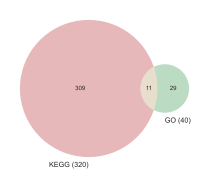

In [159]:
KEGG_GO_venn(mitochondrial_biogenesis_brite_genes, mitochondrial_biogenesis_nodes)


### oxidative stress

<hr />

<h4 class='no_toc'>GO</h4>

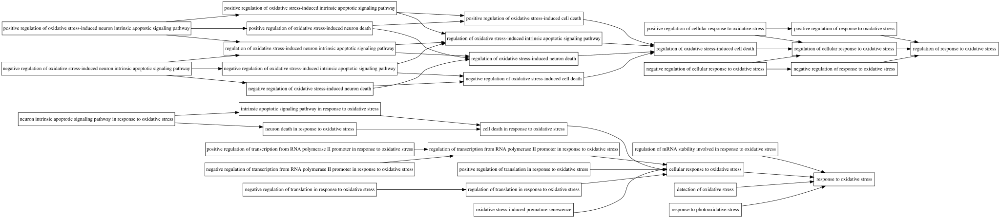

In [160]:
oxidative_stress_subgraph, oxidative_stress_nodes = GO_subgraph_from_query('oxidative stress')
draw_graph(oxidative_stress_subgraph)

In [161]:
oxidative_stress_nodes.to_pickle('targets/oxidative_stress_GO.pickle')